In [2]:
import torch
from torch import nn
from torch.optim import AdamW
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torch.utils.data import Dataset, DataLoader, random_split
from torchvision import models
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder
import albumentations as A
from albumentations.pytorch import ToTensor
from PIL import Image
import numpy as np
import logging
from addict import Dict
import os
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
from datetime import datetime, date
import random


ImportError: cannot import name 'ToTensor' from 'albumentations.pytorch' (c:\Users\mustu\anaconda3\Lib\site-packages\albumentations\pytorch\__init__.py)

Number of images of Apple leaf: 82 || Number of images of Apple rust leaf: 78 || Number of images of Apple Scab Leaf: 83 || Number of images of Bell_pepper leaf: 53 || Number of images of Bell_pepper leaf spot: 62 || Number of images of Blueberry leaf: 104 || Number of images of Cherry leaf: 47 || Number of images of Corn Gray leaf spot: 64 || Number of images of Corn leaf blight: 179 || Number of images of Corn rust leaf: 106 || Number of images of grape leaf: 57 || Number of images of grape leaf black rot: 56 || Number of images of Peach leaf: 102 || Number of images of Potato leaf early blight: 108 || Number of images of Potato leaf late blight: 97 || Number of images of Raspberry leaf: 112 || Number of images of Soyabean leaf: 57 || Number of images of Squash Powdery mildew leaf: 124 || Number of images of Strawberry leaf: 88 || Number of images of Tomato Early blight leaf: 79 || Number of images of Tomato leaf: 55 || Number of images of Tomato leaf bacterial spot: 101 || Number of

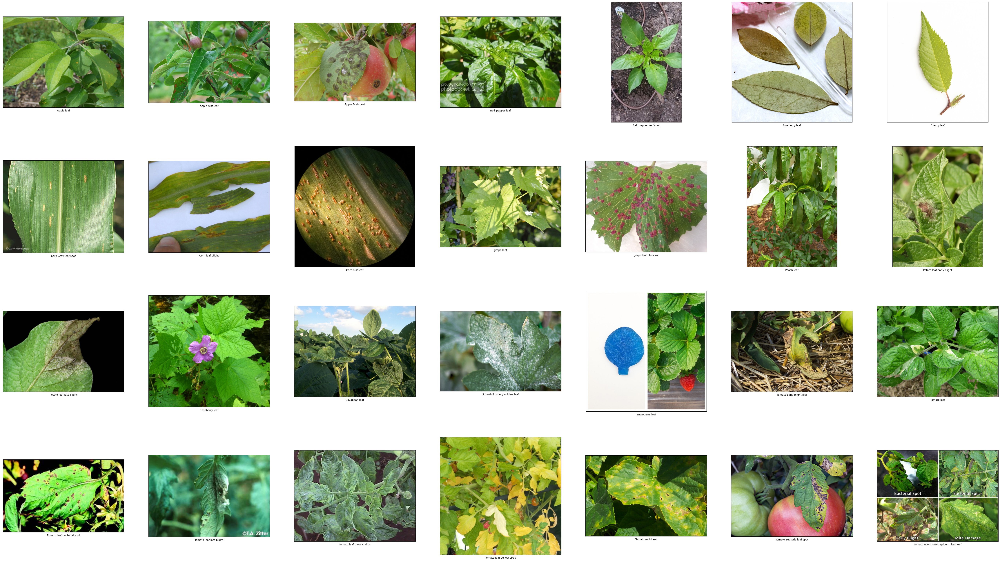

In [15]:
class FlowersDataset(Dataset):
    def __init__(self, path:str, shape=(256, 256), augmentations=None):
        self.__images_classes_pathes = []
        self.__shape = shape
        self.__augmentations = augmentations
        self.labels = []
            
        if os.path.exists(path):
            self.__path = path
            folders = [_ for _ in os.listdir(self.__path) if _ != "train"]

            for folder in folders:
                folder_path = os.path.join(self.__path, folder)
                if os.path.isdir(folder_path) and os.path.exists(folder_path):
                    images = os.listdir(folder_path)
                    self.labels.append(folder)
                    
                    
                    if len(images):
                        for image in images:
                            if image.endswith("jpeg") or image.endswith("png") or image.endswith("jpg"):
                                image_path = os.path.join(folder_path, image)
                                self.__images_classes_pathes.append((folder, image_path))
                    else:
                        message = f"Images for folder '{folder}' weren't found!"
                        print(message)
                else:
                    message = f"'{folder}' is not folder and it will be skipped!"
                    print(message)
                
        else:
            message = f"Path '{path}' does not exists!"
            raise Exception(message)
    
        self.__images_classes_pathes = np.array(self.__images_classes_pathes)
        
    
    
    
    def __load_image(self, path, channels="RGB"):
        width, height = self.__shape
        loader = A.Compose([
            A.Resize(width, height),
            ToTensor(),
        ])
        
        image = np.array(Image.open(path).convert(channels))
        return loader(image=image)["image"]
    
    def __len__(self):
        return len(self.__images_classes_pathes)
    
    
    def __getitem__(self, index):
        item = self.__images_classes_pathes[index]
        label, image_path = item
        
        image = self.__load_image(image_path, channels="RGB")
        
        if self.__augmentations is not None:
            image = self.__augmentations(image=image.permute(1, 2, 0).numpy())["image"]
        
        label = self.labels.index(label)
        
        return Dict({
            "label": label,
            "image": image
        })
    
    
class Trainer:
    def __init__(self, model, criterion, optimizer, scheduler=None, metric=None, device="cpu"):
        self.__model = model
        self.__criterion = criterion
        self.__optimizer = optimizer
        self.__scheduler = scheduler
        self.__metric = metric
        self.__device = device
        self.logs = Dict({})
        
        
    def __log(self, logs):
        for k,v in logs.items():
            if k not in self.logs.keys():
                self.logs[k] = []
                
            self.logs[k].append(v)
        
        
    def __make_checkpoint(self, info, path=f"checkpoints/checkpoint.pt"):
        checkpoint_info = {
           **info,
            "optimizer_state": self.__optimizer.state_dict(),
            "model_state": self.__model.state_dict(),
        }
        
        torch.save(checkpoint_info, path)
    
    
    def evaluate(self, loader):
        loss = 0
        length = len(loader)
        with torch.no_grad():
            loop = tqdm(loader)
            loop.set_description("Evaluating")
            for batch in loop:
                torch.cuda.empty_cache()
                images = batch["images"].to(self.__device)
                labels = batch["labels"].to("cpu")
                        
                output = self.__model(images).to("cpu")
                        
                batch_loss = criterion(output, labels)
                loss += batch_loss.item()
            
        loss /= length
        
        return loss
    
    def save(self, path="model.pt"):
        torch.save(self.__model.state_dict(), path)
        
        
    def fit(self, loader, epochs=10, validation_loader=None):
        model.to(self.__device)
        train_length = len(loader)
        
        best_validation_loss = 0
        for epoch in range(epochs):
            epoch_loss = 0
            
            loop = tqdm(loader, position=0, leave=True)
            loop.set_description(f"Epoch [{epoch+1}/{epochs}]")
            for batch in loop:
                torch.cuda.empty_cache()
                optimizer.zero_grad()
                
                images = batch["images"].to(self.__device)
                labels = batch["labels"].to("cpu")
                
                output = self.__model(images).to("cpu")
                predicted_class = torch.argmax(output, dim=1)
        
                loss = self.__criterion(output, labels)
                
                epoch_loss += loss.item()
                
                loop.set_postfix(loss=loss.item())
                
                loss.backward()
                optimizer.step()
            
            epoch_loss /= train_length
            
            self.__log({"epochs": epoch+1, "train_loss": epoch_loss})
            loop.set_postfix(loss=epoch_loss)
            
            if validation_loader is not None:
                validation_loss = self.evaluate(validation_loader)
                self.__log({"validation_loss": validation_loss})
            
                rounded_loss = np.round(validation_loss, 3)
                if rounded_loss > best_validation_loss:
                    now = datetime.now().strftime("%H:%M:%S %d.%m.%Y")
                    checkpoint_path = f"{rounded_loss}_{now}.pt"

                    checkpoint_info =  {
                        "epoch": epoch+1,
                        "loss": validation_loss
                    }

                    self.__make_checkpoint(info=checkpoint_info, path=checkpoint_path)

                    best_validation_loss = rounded_loss
                
                if self.__scheduler is not None:
                    self.__scheduler.step(validation_loss)
                    
            else:
                if self.__scheduler is not None:
                    self.__scheduler.step()
            
            lr = self.__optimizer.defaults["lr"]
            self.__log({"lr": lr})
            
    
def collate_fn(batch):
    images, labels = [], []
    
    for item in batch:
        label, image = item.label, item.image.tolist()
        
        images.append(image)
        labels.append(label)
        
    return {
        "images": torch.tensor(images),
        "labels": torch.tensor(labels)
    }


def train_test_split(dataset, test_size=0.2):
    length = len(dataset)
    train_length = round(length * (1 - test_size))
    test_length = length - train_length
    
    train_dataset, test_dataset = random_split(dataset, [train_length, test_length])
    return train_dataset, test_dataset


In [16]:
print(plant_names)
print(len(plant_names))

['Apple leaf', 'Apple rust leaf', 'Apple Scab Leaf', 'Bell_pepper leaf', 'Bell_pepper leaf spot', 'Blueberry leaf', 'Cherry leaf', 'Corn Gray leaf spot', 'Corn leaf blight', 'Corn rust leaf', 'grape leaf', 'grape leaf black rot', 'Peach leaf', 'Potato leaf early blight', 'Potato leaf late blight', 'Raspberry leaf', 'Soyabean leaf', 'Squash Powdery mildew leaf', 'Strawberry leaf', 'Tomato Early blight leaf', 'Tomato leaf', 'Tomato leaf bacterial spot', 'Tomato leaf late blight', 'Tomato leaf mosaic virus', 'Tomato leaf yellow virus', 'Tomato mold leaf', 'Tomato Septoria leaf spot', 'Tomato two spotted spider mites leaf']
28


In [17]:
import tensorflow
from tensorflow import keras
from keras.models import Sequential,load_model,Model
from keras.layers import Conv2D,MaxPool2D,AveragePooling2D,Dense,Flatten,ZeroPadding2D,BatchNormalization,Activation,Add,Input,Dropout,GlobalAveragePooling2D
from keras.optimizers import SGD
from keras.initializers import glorot_uniform
from keras.preprocessing.image import ImageDataGenerator
from keras.callbacks import ModelCheckpoint,EarlyStopping,ReduceLROnPlateau

In [18]:
from keras.applications import ResNet50
from keras.applications.resnet50 import preprocess_input

In [19]:
base_model_tf=ResNet50(include_top=False,weights='imagenet',input_shape=(224,224,3),classes=38)

In [20]:
#Model building
base_model_tf.trainable=False

pt=Input(shape=(224,224,3))
func=tensorflow.cast(pt,tensorflow.float32)
x=preprocess_input(func) #This function used to zero-center each color channel wrt Imagenet dataset
model_resnet=base_model_tf(x,training=False)
model_resnet=GlobalAveragePooling2D()(model_resnet)
model_resnet=Dense(128,activation='relu')(model_resnet)
model_resnet=Dense(64,activation='relu')(model_resnet)
model_resnet=Dense(28,activation='softmax')(model_resnet)


model_main=Model(inputs=pt,outputs=model_resnet)
model_main.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 tf.cast_1 (TFOpLambda)      (None, 224, 224, 3)       0         
                                                                 
 tf.__operators__.getitem_1  (None, 224, 224, 3)       0         
  (SlicingOpLambda)                                              
                                                                 
 tf.nn.bias_add_1 (TFOpLamb  (None, 224, 224, 3)       0         
 da)                                                             
                                                                 
 resnet50 (Functional)       (None, 7, 7, 2048)        23587712  
                                                                 
 global_average_pooling2d_1  (None, 2048)              0   

In [21]:
#Image augmentation
train_datagen= ImageDataGenerator(shear_range=0.2,zoom_range=0.2,horizontal_flip=False,vertical_flip=False
                                  ,fill_mode='nearest',width_shift_range=0.2,height_shift_range=0.2)

val_datagen=ImageDataGenerator()

path_train='./data/train'

path_valid='./data/test'

train= train_datagen.flow_from_directory(directory=path_train,batch_size=32,target_size=(224,224),
                                         color_mode='rgb',class_mode='categorical',seed=42)

valid=val_datagen.flow_from_directory(directory=path_valid,batch_size=32,target_size=(224,224),color_mode='rgb',class_mode='categorical')

Found 2336 images belonging to 28 classes.
Found 236 images belonging to 27 classes.


In [22]:
#CallBacks
es=EarlyStopping(monitor='val_accuracy',verbose=1,patience=7,mode='auto')
mc=ModelCheckpoint(filepath='/content',monitor='val_accuracy',verbose=1,save_best_only=True)
lr=ReduceLROnPlateau(monitor='val_accuracy',verbose=1,patience=5,min_lr=0.001)

In [23]:
model_main.compile(optimizer='Adam',loss='categorical_crossentropy',metrics=['accuracy'])

In [24]:
model_main.fit(train,epochs=100,steps_per_epoch=20,verbose=1,callbacks=[mc,es,lr])

Epoch 1/100
 6/20 [========>.....................] - ETA: 24s - loss: 3.3932 - accuracy: 0.0781

UnknownError: Graph execution error:

FileNotFoundError: [Errno 2] No such file or directory: './data/train\\Apple leaf\\apple-tree-branch-blossom-plant-fruit-berry-leaf-flower-food-green-produce-evergreen-flora-sad-shrub-apples-branch-with-apples-flowering-plant-rose-family-acerola-malpighia-woody-plant-land-plant-928225.jpg'
Traceback (most recent call last):

  File "c:\Users\mustu\AppData\Local\Programs\Python\Python310\lib\site-packages\tensorflow\python\ops\script_ops.py", line 268, in __call__
    ret = func(*args)

  File "c:\Users\mustu\AppData\Local\Programs\Python\Python310\lib\site-packages\tensorflow\python\autograph\impl\api.py", line 643, in wrapper
    return func(*args, **kwargs)

  File "c:\Users\mustu\AppData\Local\Programs\Python\Python310\lib\site-packages\tensorflow\python\data\ops\from_generator_op.py", line 198, in generator_py_func
    values = next(generator_state.get_iterator(iterator_id))

  File "c:\Users\mustu\AppData\Local\Programs\Python\Python310\lib\site-packages\keras\src\engine\data_adapter.py", line 917, in wrapped_generator
    for data in generator_fn():

  File "c:\Users\mustu\AppData\Local\Programs\Python\Python310\lib\site-packages\keras\src\engine\data_adapter.py", line 1064, in generator_fn
    yield x[i]

  File "c:\Users\mustu\AppData\Local\Programs\Python\Python310\lib\site-packages\keras\src\preprocessing\image.py", line 116, in __getitem__
    return self._get_batches_of_transformed_samples(index_array)

  File "c:\Users\mustu\AppData\Local\Programs\Python\Python310\lib\site-packages\keras\src\preprocessing\image.py", line 370, in _get_batches_of_transformed_samples
    img = image_utils.load_img(

  File "c:\Users\mustu\AppData\Local\Programs\Python\Python310\lib\site-packages\keras\src\utils\image_utils.py", line 422, in load_img
    with open(path, "rb") as f:

FileNotFoundError: [Errno 2] No such file or directory: './data/train\\Apple leaf\\apple-tree-branch-blossom-plant-fruit-berry-leaf-flower-food-green-produce-evergreen-flora-sad-shrub-apples-branch-with-apples-flowering-plant-rose-family-acerola-malpighia-woody-plant-land-plant-928225.jpg'


	 [[{{node PyFunc}}]]
	 [[IteratorGetNext]] [Op:__inference_train_function_21013]